# **Initial install libs**


# **Imports**

In [1]:
import os
import gc
from time import time
from itertools import combinations
from typing import Union

import cv2
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import skfuzzy as fuzz
from sklearn.cluster import KMeans, AffinityPropagation
from sklearn_extra.cluster import KMedoids
import seaborn as sns
from tqdm.notebook import tqdm

%matplotlib inline

sns.set_context('notebook', rc={"lines.linewidth": 1})

# **General functions**

In [2]:
def hi_bany(recreated_img: np.ndarray,
            labels: dict,
            norm: int = 2):
    
    """
    Hi-Bany score
    defined as ratio: 
        (sum of distances between points inside one cluster)/
        (sum of distances between points inside different clusters)
    """
    combined_ = list(zip(labels, recreated_img.reshape(-1,3)))
    labels_ = list(set(labels.keys()))
    intercluster_samples = lambda i: filter(lambda t: t[0] == i,
                                             combined_)
    intercluster_dist = np.sum([
                           np.sum([
                                np.linalg.norm(x-labels[i], 
                                               ord=norm) for (_, x) 
                                in intercluster_samples(i)
                                ]) 
                          for i in labels_
                          ])
    outercluster_dist = np.sum([
                            np.sum([
                              np.linalg.norm(sample_i[1]-labels[j], 
                                               ord=norm)    
                             for sample_i in intercluster_samples(i)
                             ])
                          for i,j in combinations(labels_,2)
                          ])
    return intercluster_dist/outercluster_dist

def readimage():
    folder = 'Лаба 2/'
    list_images = os.listdir(folder)
    list_img = []
    for i in list_images:
        if not i.endswith('.jpg'):
            continue
        path = folder+i
        print(path)
        img = plt.imread(path, cv2.IMREAD_COLOR)
        list_img.append((i, img))
    return list_img

  

# **Read images**

In [3]:
list_img = readimage()

Лаба 2/1_машина.jpg
Лаба 2/1_машина2.jpg
Лаба 2/2_животные (2).jpg
Лаба 2/2_животные.jpg
Лаба 2/3_бактерии.jpg
Лаба 2/3_бактерии2.jpg
Лаба 2/4_фрукты (2).jpg
Лаба 2/4_фрукты.jpg
Лаба 2/5_попугай.jpg
Лаба 2/5_попугай2.jpg
Лаба 2/6_kosmos.jpg
Лаба 2/6_космос.jpg
Лаба 2/7_схема.jpg
Лаба 2/7_схема2.jpg
Лаба 2/8_крыши 2.jpg
Лаба 2/8_крыши.jpg


# **TEST**

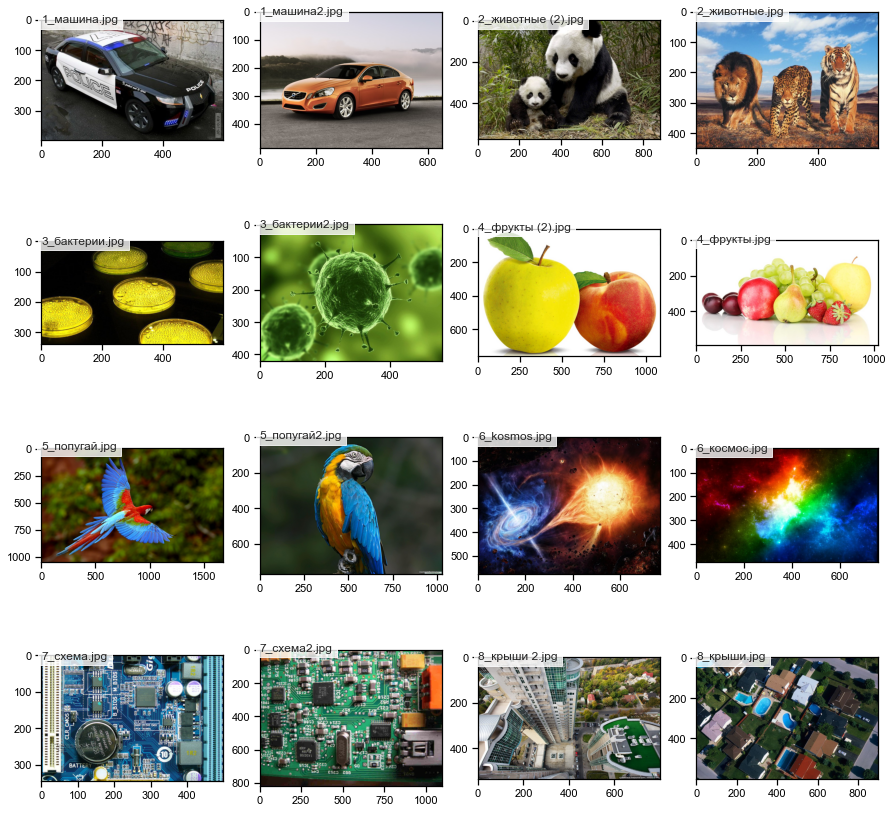

In [4]:
f, ax = plt.subplots(4, 4, figsize=(15,15))
ax = ax.flatten()
with sns.axes_style("white"):
    for i, (path, rgb_obj) in enumerate(list_img):
        ax[i].imshow(rgb_obj)
        ax[i].text(0.5, 10,
                      f'{path}',
                      bbox={'facecolor':'white',
                            'alpha':0.8})
        ax[i].grid(False)
    plt.show()
    plt.close()
del f, ax

# **K-means, C-means**

## **Functions**

In [5]:
def cmeans_clustering(img: np.ndarray, 
                      num_clusters: int = 3, 
                      **kwargs) -> Union[np.ndarray, dict]:
  """
  Perform fuzzy C-means segmentation on given image
  """
  img_2d = img.reshape((-1,3)) #in order to have 2d-array of colored pixels
  cntr, u, _, _, _, _, _ = fuzz.cmeans(img_2d.T, num_clusters, **kwargs)
  labels = np.argmax(u, axis=0)
  segmented = cntr[labels]\
    .astype('uint8')\
    .reshape(img.shape)
  return segmented, {k:v for k,v in enumerate(cntr)}

def kmeans_clustering(img: np.ndarray, 
                      num_clusters: int = 3, 
                      **kwargs) -> Union[np.ndarray, dict]:
  """
  Perform K-means segmentation on image
  """
  img_2d = img.reshape((-1,3)) #in order to have 2d-array of colored pixels
  km = KMeans(num_clusters, **kwargs).fit(img_2d)
  segmented = km.cluster_centers_[km.labels_]\
    .astype('uint8')\
    .reshape(img.shape)
  return segmented, {k:v for k,v in enumerate(km.cluster_centers_)} 

## **Processing**

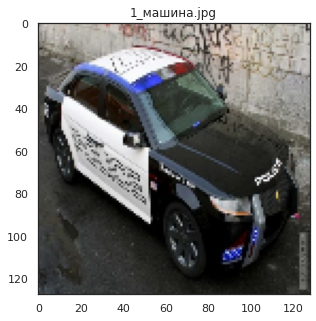

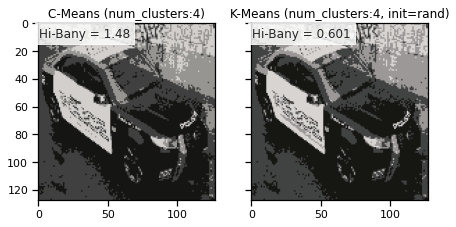

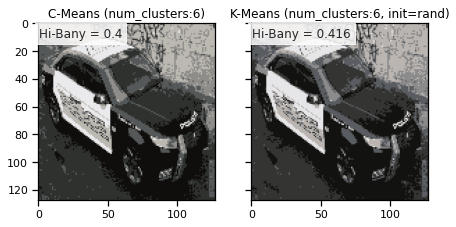

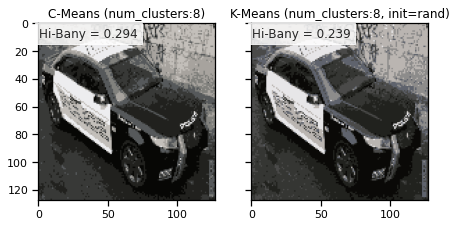

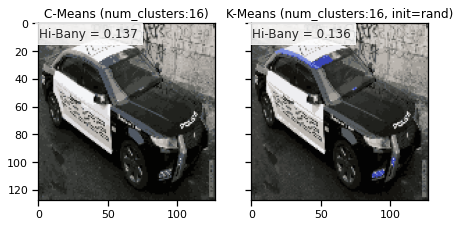

...

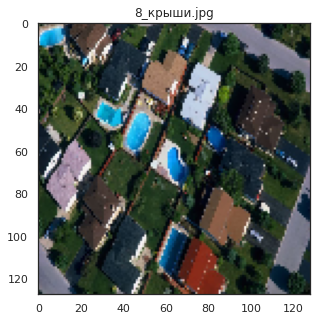

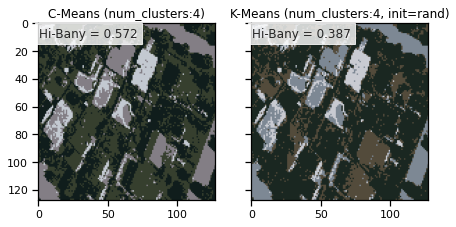

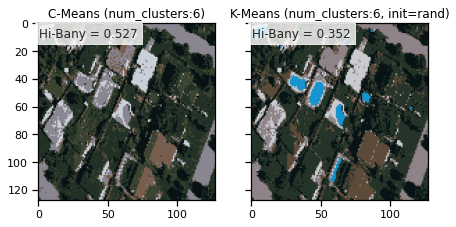

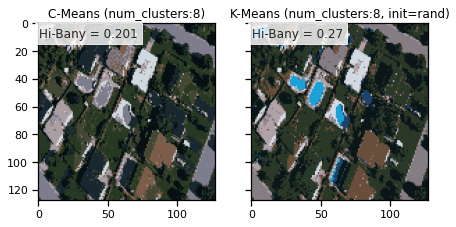

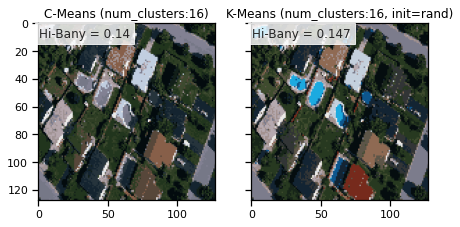

In [6]:
clusters = [4, 6, 8, 16]
stats = dict(img=[], num_clusters=[], 
             cmeans_hibany=[], kmeans_hibany=[])
# looping every image
for _, (path, rgb_obj) in enumerate(list_img):
    rgb_img = cv2.resize(rgb_obj,(128,128))
    with sns.axes_style("white"):
        plt.figure(figsize=(5,5))
        plt.imshow(rgb_img)
        plt.title(path)
    # looping every cluster     
    for i,cluster in tqdm(enumerate(clusters), 
                          total = len(clusters),
                               desc=f'Processing clusterization for {path}',
                               ncols=10,
                               dynamic_ncols=True, unit='iter'):
        f, ax = plt.subplots(1, 2, figsize=(7,7), sharex=True, sharey=True)
        
        cm_segm, cm_l = cmeans_clustering(rgb_img, 
                                   cluster, 
                                   m=2, 
                                   error=1e-2, 
                                   maxiter=200)
        hib_c = hi_bany(cm_segm,cm_l)
        km_segm, km_l = kmeans_clustering(rgb_img, 
                                    cluster, 
                                    n_init=10, 
                                    tol=1e-2, 
                                    max_iter=200,
                                    init='random')
        hib_k = hi_bany(km_segm,km_l)
        gc.collect()
        with sns.axes_style("white"):
            ax[0].imshow(cm_segm)
            ax[0].set_title(f'C-Means (num_clusters:{cluster})')
            ax[0].text(0.5, 10,
                      f'Hi-Bany = {np.round(hib_c,3)}',
                      bbox={'facecolor':'white',
                            'alpha':0.8})
            ax[0].grid(False)
            ax[1].imshow(km_segm)
            ax[1].set_title(f'K-Means (num_clusters:{cluster}, init=rand)')
            ax[1].text(0.5,10,
                      f'Hi-Bany = {np.round(hib_k,3)}',
                      bbox={'facecolor':'white',
                            'alpha':0.8})
            ax[1].grid(False)
        stats['img'].append(path)
        stats['cmeans_hibany'].append(hib_c)
        stats['kmeans_hibany'].append(hib_k)
        stats['num_clusters'].append(cluster)
        gc.collect()
        del hib_c, hib_k, km_segm, km_l, cm_segm, cm_l
    plt.show()

In [7]:
stats = pd.DataFrame(stats)

## **Visualizing Hi-Bany scores for clustering**

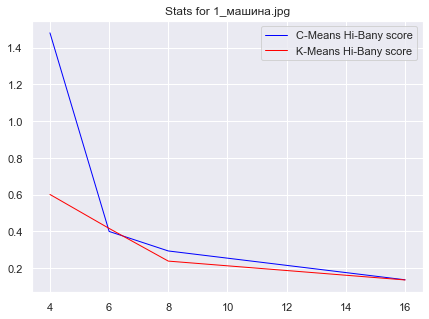

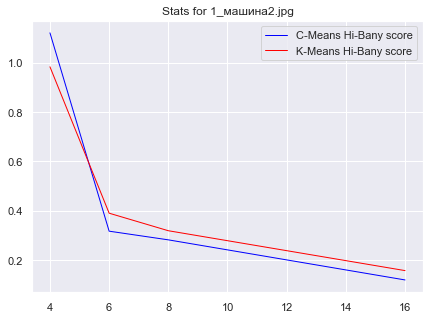

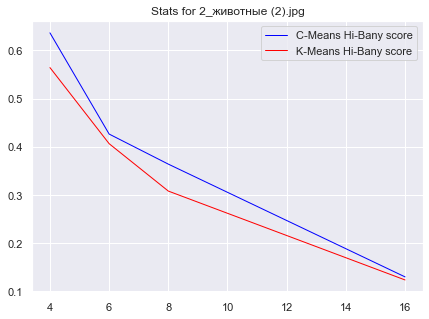

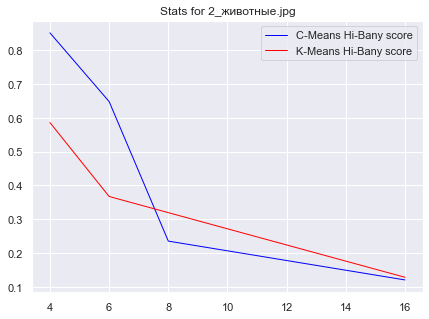

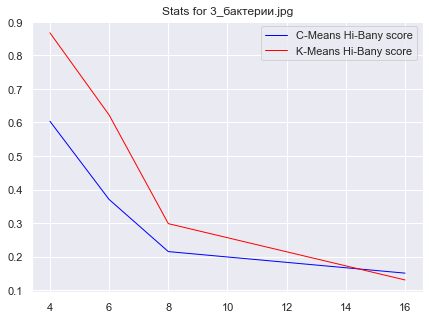

...

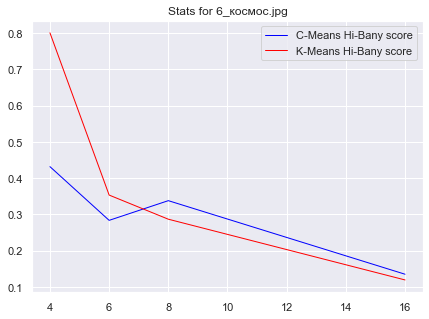

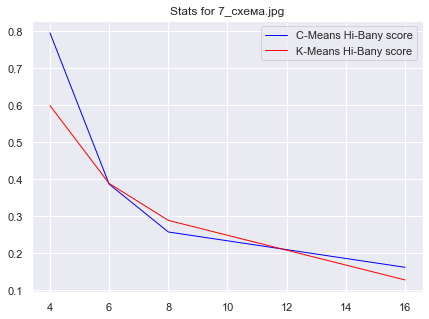

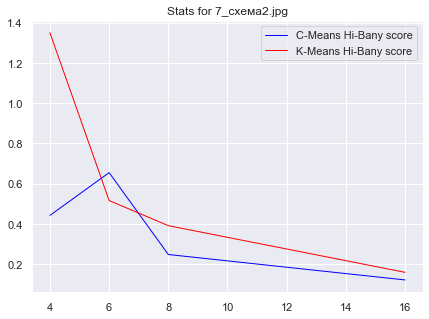

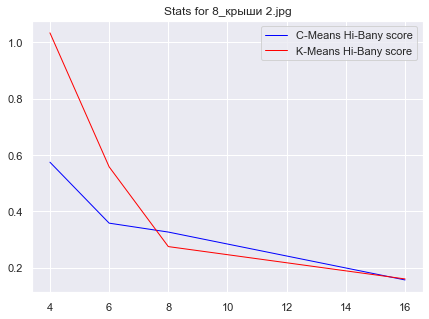

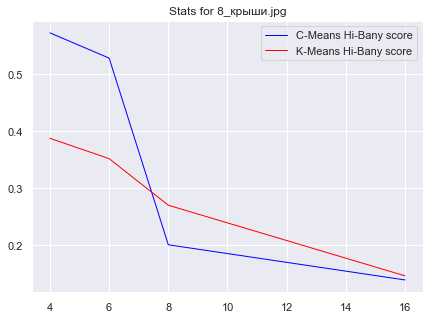

In [8]:
for img_ in stats.img.unique():
  df1=stats[stats.img==img_]
  with sns.axes_style('darkgrid'):
    f, ax = plt.subplots(1, 1, figsize=(7,5))
    ax.plot(df1.num_clusters, df1.cmeans_hibany, color="blue", 
            label="C-Means Hi-Bany score", linestyle="-")
    ax.plot(df1.num_clusters, df1.kmeans_hibany, color="red", 
            label="K-Means Hi-Bany score", linestyle="-")
    plt.title(f'Stats for {img_}')
    ax.legend()
    plt.show()
  

# **K-means++, K-Medoids**

## **Functions**

In [9]:
def kmedoids_clustering(img: np.ndarray, 
                      num_clusters: int=3, 
                      **kwargs) -> np.ndarray:
  """
  Perform K-medoids segmentation on image
  """
  img_2d = img.reshape((-1,3)) #in order to have 2d-array of colored pixels
  kmedoids = KMedoids(n_clusters=num_clusters, **kwargs).fit(img_2d)
  segmented = kmedoids.cluster_centers_[kmedoids.labels_]\
    .astype('uint8')\
    .reshape(img.shape)
  return segmented, {k:v for k,v in enumerate(kmedoids.cluster_centers_)} 

def affinity_prop_clustering(img: np.ndarray, 
                      num_clusters: int=3, 
                      **kwargs) -> np.ndarray:
  """
  Perform Affinity Propagation segmentation on image
  """
  img_2d = img.reshape((-1,3)) #in order to have 2d-array of colored pixels
  ap = AffinityPropagation(preference=-1*num_clusters, **kwargs).fit(img_2d)
  print(ap.n_iter_)
  segmented = ap.cluster_centers_[ap.labels_]\
    .astype('uint8')\
    .reshape(img.shape)
  return segmented, {k:v for k,v in enumerate(ap.cluster_centers_)} 


## **Processing**

C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 4 is empty! self.labels_[self.medoid_indices_[4]] may not be labeled with its corresponding cluster (4).
  warnings.warn(
C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 5 is empty! self.labels_[self.medoid_indices_[5]] may not be labeled with its corresponding cluster (5).
  warnings.warn(
C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 4 is empty! self.labels_[self.medoid_indices_[4]] may not be labeled with its corresponding cluster (4).
  warnings.warn(
C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 5 is empty! self.labels_[self.medoid_indices_[5]] may not be labeled with its corresponding cluster (5).
  warnings.warn(
C:\Users\andro\AppDa

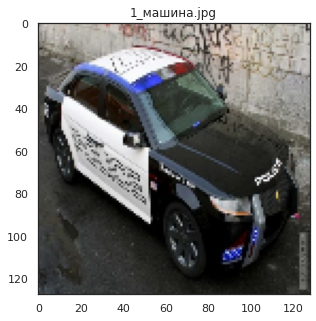

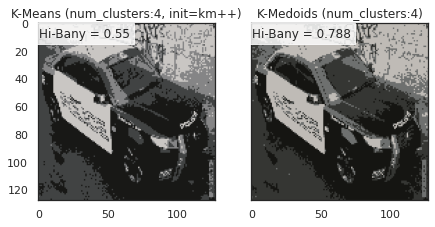

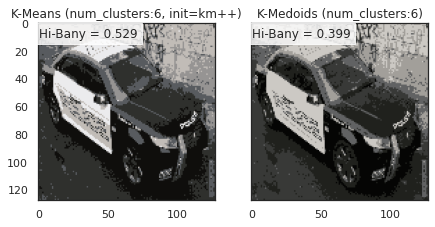

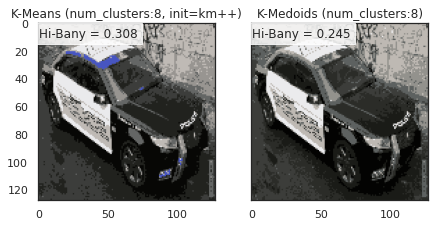

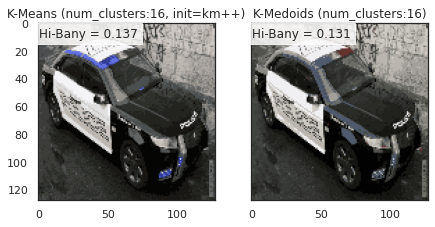

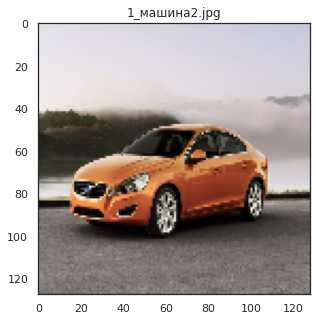

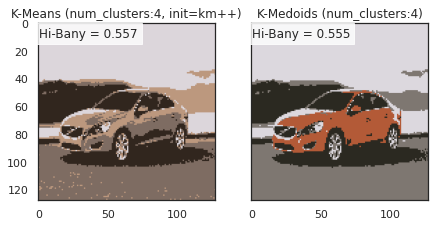

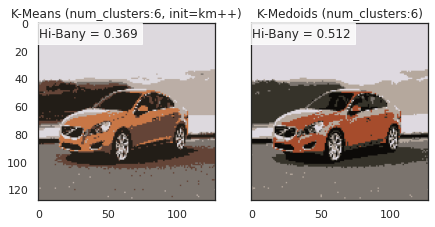

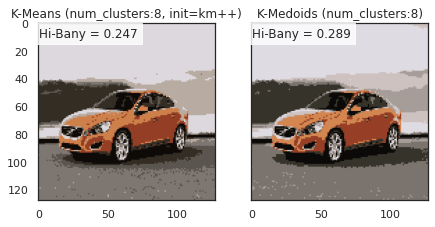

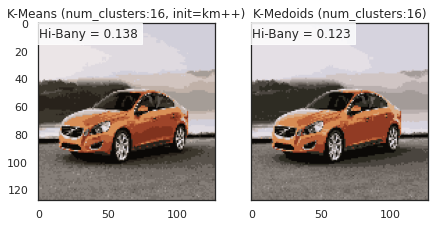

C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 1 is empty! self.labels_[self.medoid_indices_[1]] may not be labeled with its corresponding cluster (1).
  warnings.warn(
C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 3 is empty! self.labels_[self.medoid_indices_[3]] may not be labeled with its corresponding cluster (3).
  warnings.warn(
C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 3 is empty! self.labels_[self.medoid_indices_[3]] may not be labeled with its corresponding cluster (3).
  warnings.warn(
C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 7 is empty! self.labels_[self.medoid_indices_[7]] may not be labeled with its corresponding cluster (7).
  warnings.warn(
C:\Users\andro\AppDa

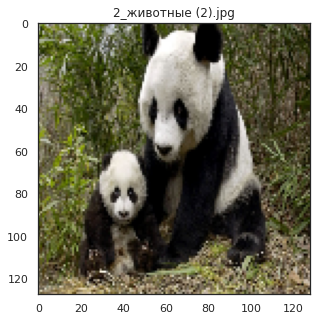

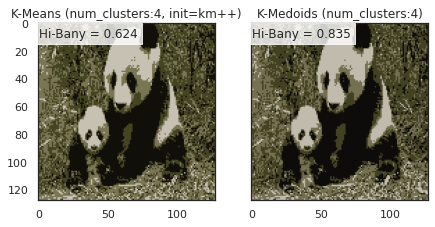

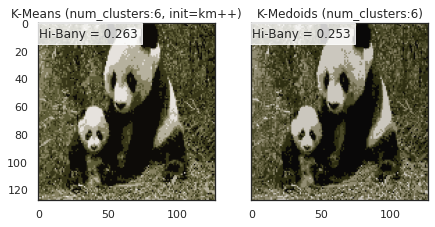

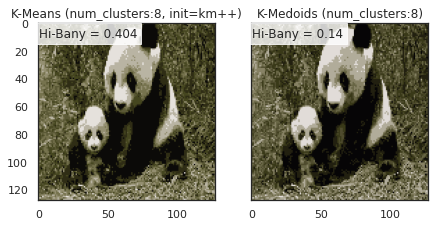

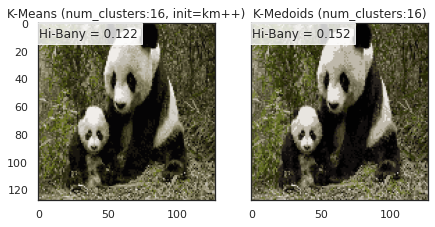

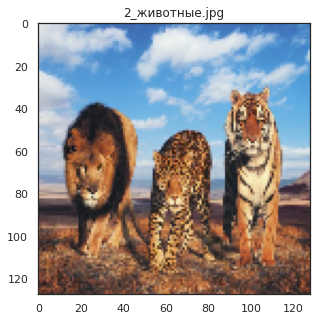

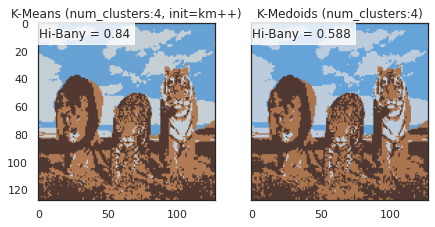

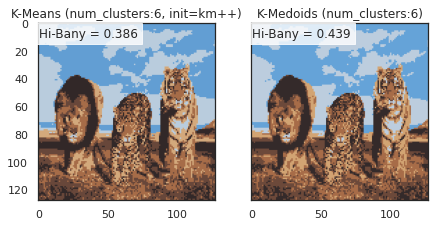

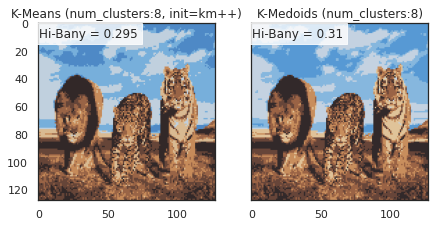

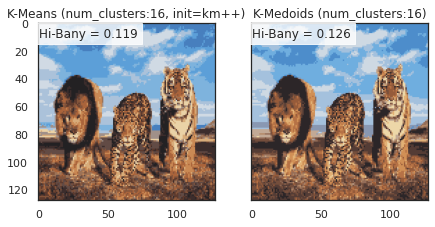

C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 2 is empty! self.labels_[self.medoid_indices_[2]] may not be labeled with its corresponding cluster (2).
  warnings.warn(
C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 3 is empty! self.labels_[self.medoid_indices_[3]] may not be labeled with its corresponding cluster (3).
  warnings.warn(
C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 2 is empty! self.labels_[self.medoid_indices_[2]] may not be labeled with its corresponding cluster (2).
  warnings.warn(
C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 3 is empty! self.labels_[self.medoid_indices_[3]] may not be labeled with its corresponding cluster (3).
  warnings.warn(
C:\Users\andro\AppDa

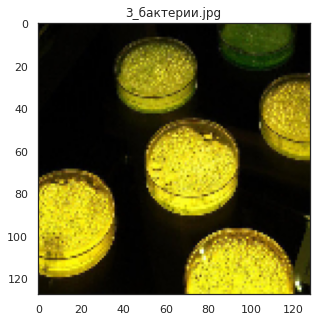

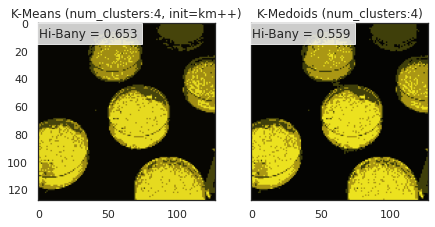

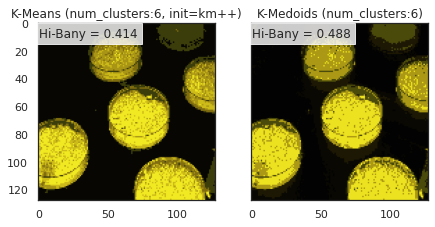

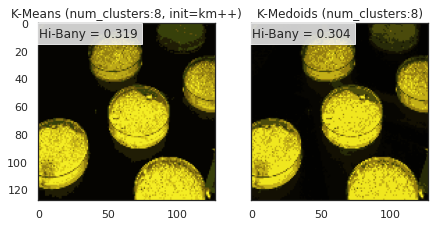

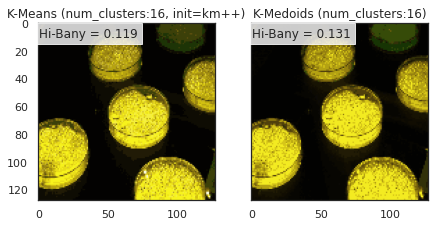

C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 3 is empty! self.labels_[self.medoid_indices_[3]] may not be labeled with its corresponding cluster (3).
  warnings.warn(
C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 9 is empty! self.labels_[self.medoid_indices_[9]] may not be labeled with its corresponding cluster (9).
  warnings.warn(
C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 15 is empty! self.labels_[self.medoid_indices_[15]] may not be labeled with its corresponding cluster (15).
  warnings.warn(


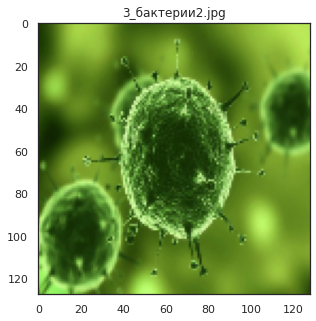

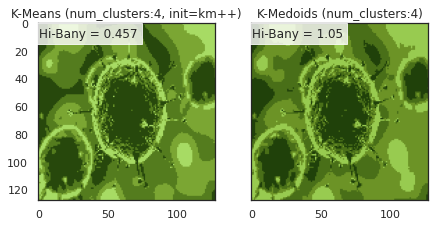

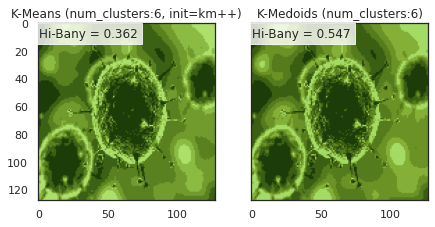

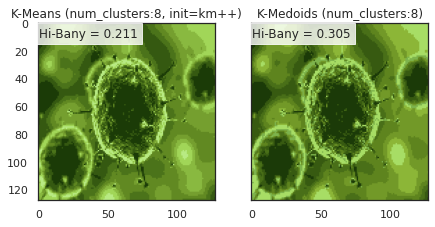

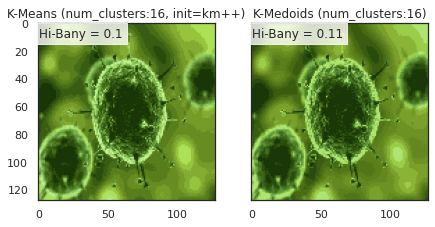

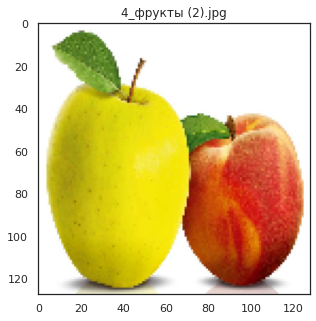

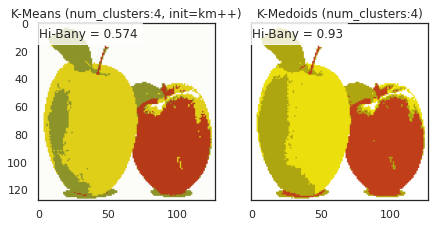

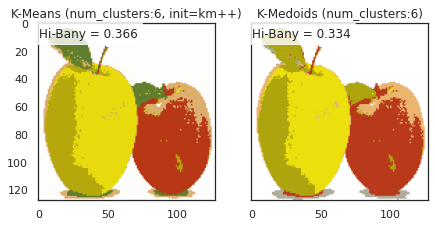

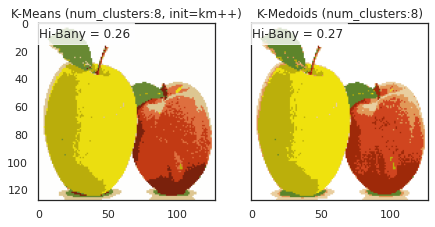

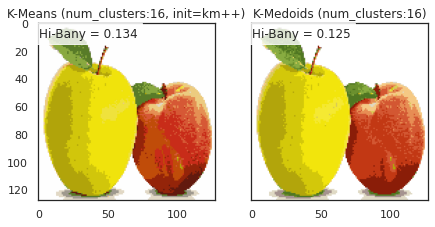

C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 7 is empty! self.labels_[self.medoid_indices_[7]] may not be labeled with its corresponding cluster (7).
  warnings.warn(
C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 8 is empty! self.labels_[self.medoid_indices_[8]] may not be labeled with its corresponding cluster (8).
  warnings.warn(
C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 14 is empty! self.labels_[self.medoid_indices_[14]] may not be labeled with its corresponding cluster (14).
  warnings.warn(


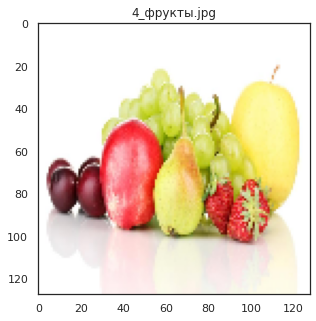

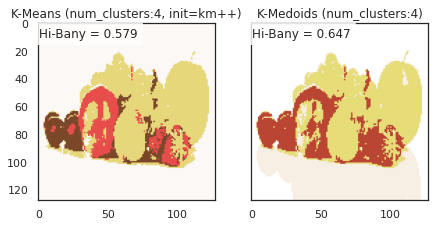

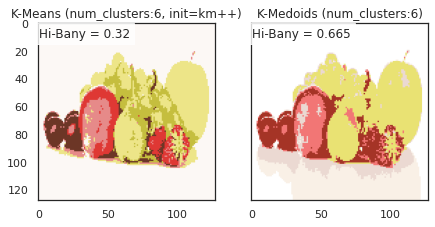

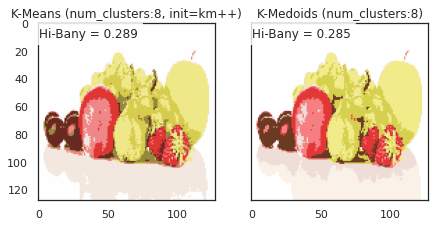

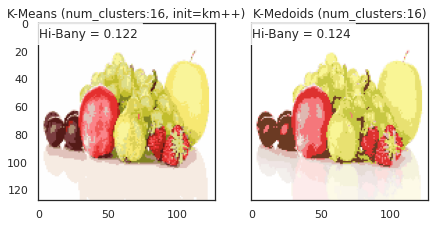

C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 8 is empty! self.labels_[self.medoid_indices_[8]] may not be labeled with its corresponding cluster (8).
  warnings.warn(
C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 9 is empty! self.labels_[self.medoid_indices_[9]] may not be labeled with its corresponding cluster (9).
  warnings.warn(


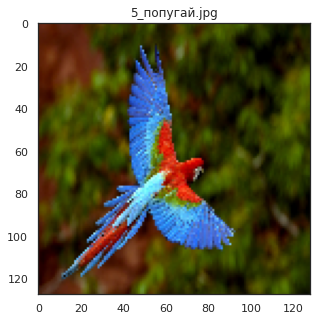

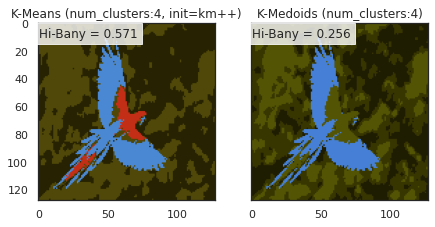

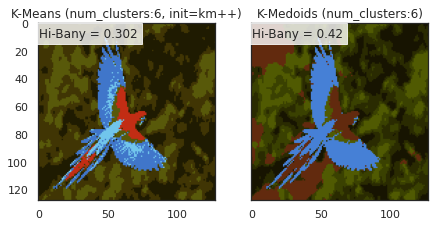

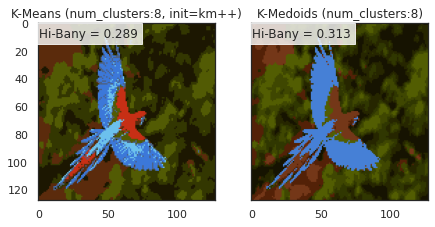

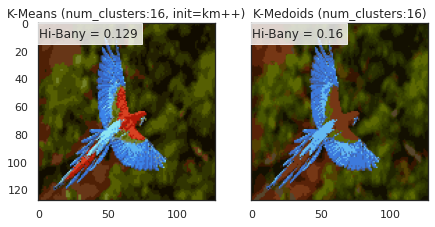

C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 4 is empty! self.labels_[self.medoid_indices_[4]] may not be labeled with its corresponding cluster (4).
  warnings.warn(
C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 4 is empty! self.labels_[self.medoid_indices_[4]] may not be labeled with its corresponding cluster (4).
  warnings.warn(
C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 7 is empty! self.labels_[self.medoid_indices_[7]] may not be labeled with its corresponding cluster (7).
  warnings.warn(
C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 1 is empty! self.labels_[self.medoid_indices_[1]] may not be labeled with its corresponding cluster (1).
  warnings.warn(
C:\Users\andro\AppDa

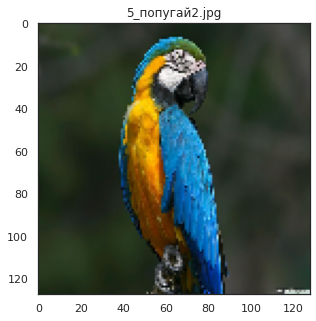

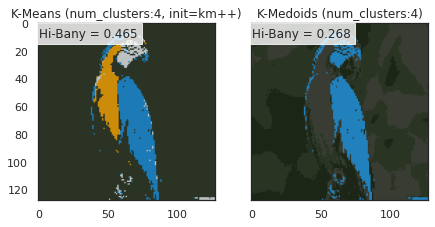

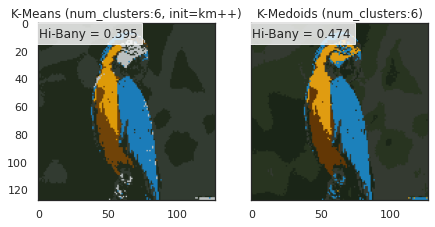

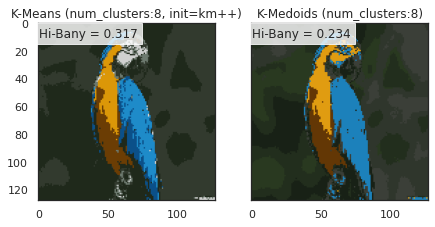

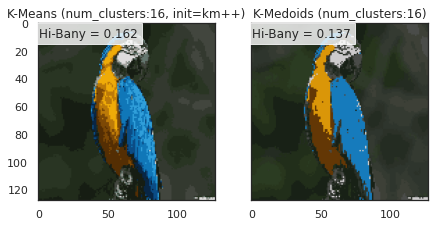

...

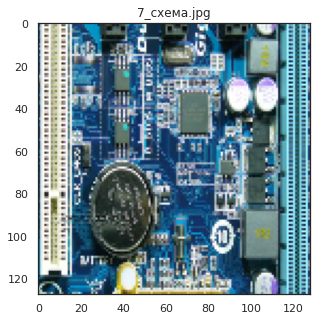

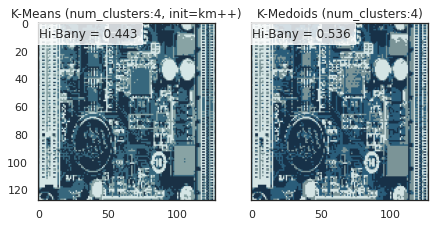

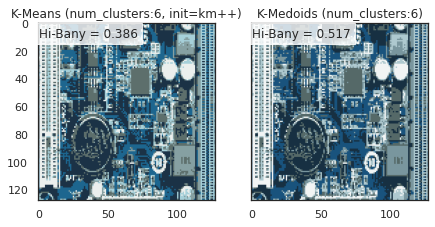

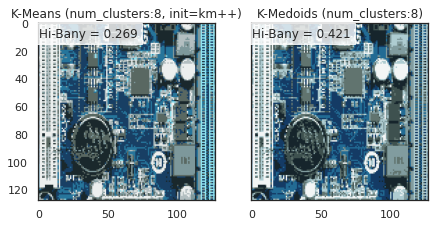

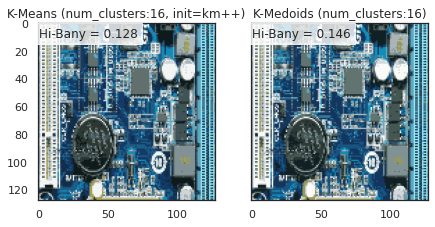

C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 14 is empty! self.labels_[self.medoid_indices_[14]] may not be labeled with its corresponding cluster (14).
  warnings.warn(


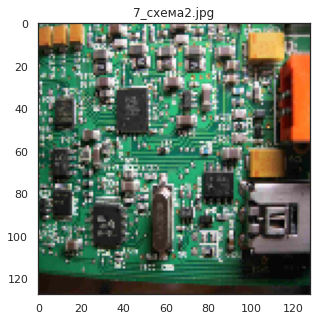

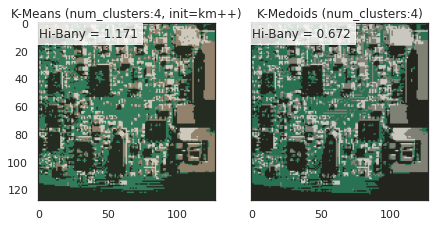

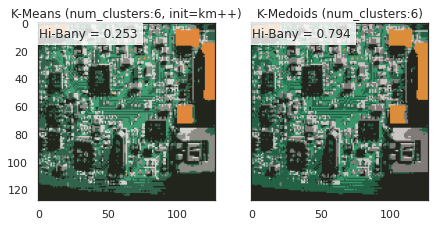

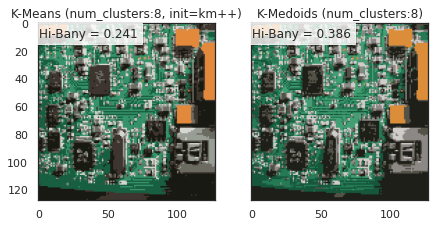

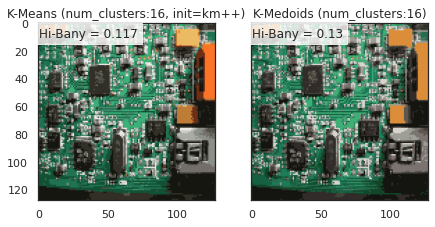

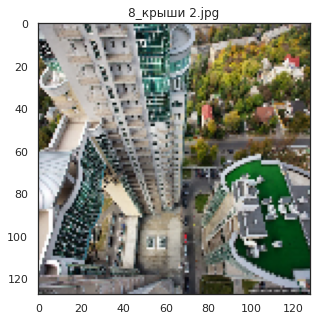

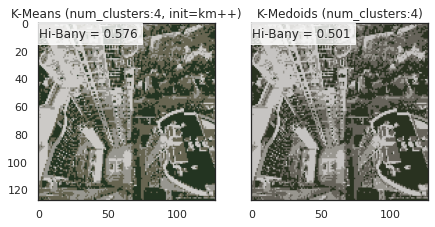

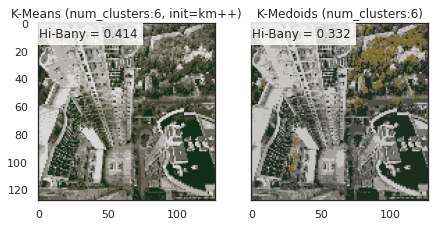

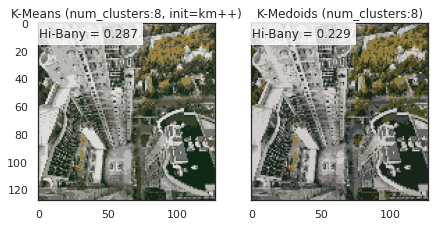

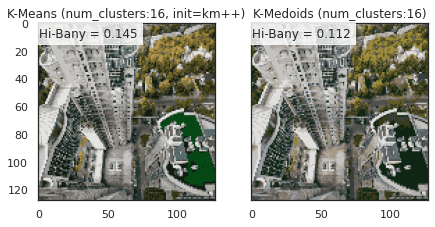

C:\Users\andro\AppData\Roaming\Python\Python38\site-packages\sklearn_extra\cluster\_k_medoids.py:231: UserWarning: Cluster 12 is empty! self.labels_[self.medoid_indices_[12]] may not be labeled with its corresponding cluster (12).
  warnings.warn(


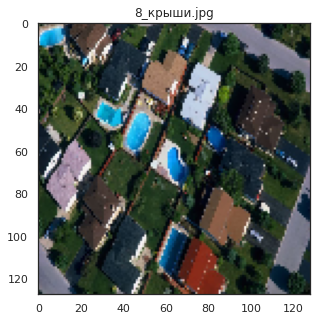

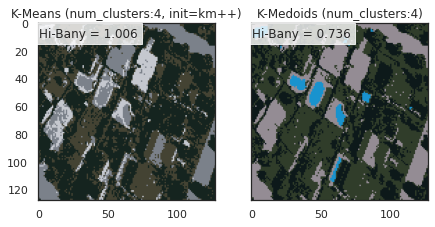

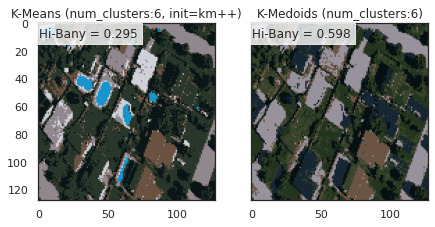

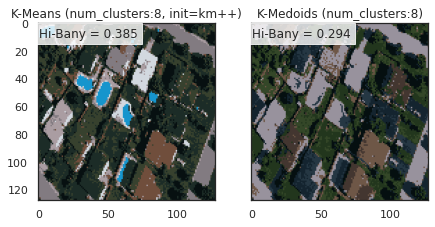

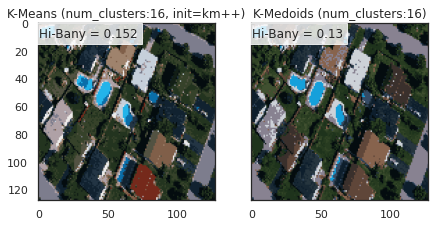

In [10]:
clusters = [4, 6, 8, 16]
stats_1 = dict(img=[], num_clusters=[], 
             kmedoids_hibany=[],
             kmeansp_hibany=[])
for (path, rgb_obj) in list_img:
    rgb_img = cv2.resize(rgb_obj,(128,128))
 
    with sns.axes_style("white"):
        plt.figure(figsize=(5,5))
        plt.imshow(rgb_img)
        plt.title(path)   
    for i,cluster in tqdm(enumerate(clusters), 
                               desc='Processing clusterization',
                               ncols=10,
                               dynamic_ncols=True, unit='iter'):
      with sns.axes_style("white"):
        f, ax = plt.subplots(1, 2, figsize=(7,7), sharex=True, sharey=True)

        kmp_segm, kmp_l = kmeans_clustering(rgb_img, 
                                    cluster, 
                                    n_init=10, 
                                    tol=1e-2, 
                                    max_iter=200,
                                    init='k-means++')
        hib_kp = hi_bany(kmp_segm,kmp_l)
        ax[0].imshow(kmp_segm)
        ax[0].set_title(f'K-Means (num_clusters:{cluster}, init=km++)')
        ax[0].text(0.5,10,
                  f'Hi-Bany = {np.round(hib_kp,3)}',
                  bbox={'facecolor':'white',
                        'alpha':0.8})
        ax[0].grid(False)
        stats_1['kmeansp_hibany'].append(hib_kp)
        kmd_segm, kmd_l = kmedoids_clustering(rgb_img, 
                                            cluster, 
                                            max_iter=200)
        hib_kmd = hi_bany(kmd_segm,kmd_l)
        ax[1].imshow(kmd_segm)
        ax[1].set_title(f'K-Medoids (num_clusters:{cluster})')
        ax[1].text(0.5,10,
                  f'Hi-Bany = {np.round(hib_kmd,3)}',
                  bbox={'facecolor':'white',
                        'alpha':0.8})
        ax[1].grid(False)
        stats_1['kmedoids_hibany'].append(hib_kmd)
        del hib_kmd, kmd_segm, kmd_l
        gc.collect()
        stats_1['img'].append(path)
        stats_1['num_clusters'].append(cluster)
        gc.collect()
    plt.show()

## **Visualizing Hi-Bany scores for additional clustering**

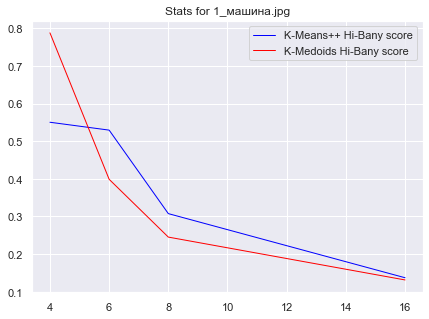

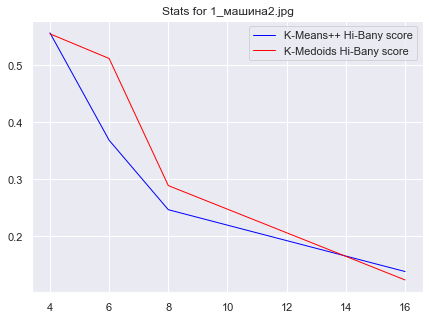

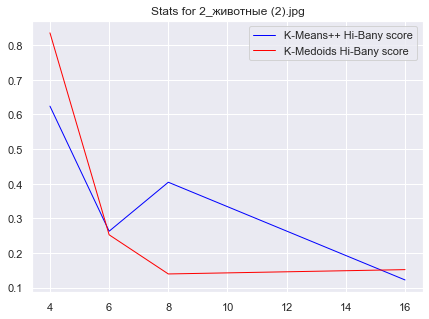

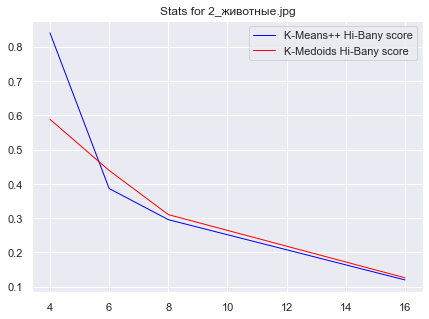

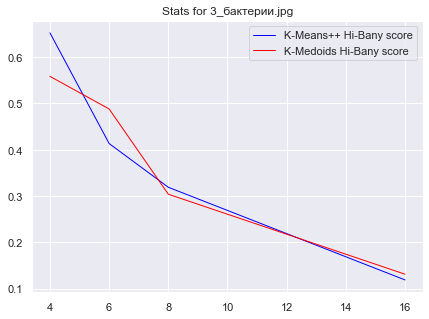

...

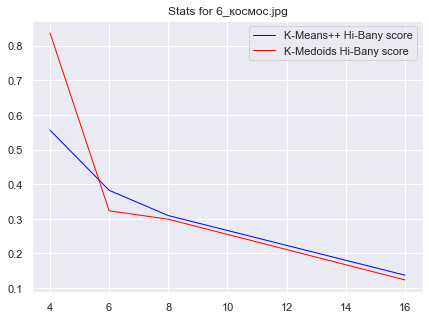

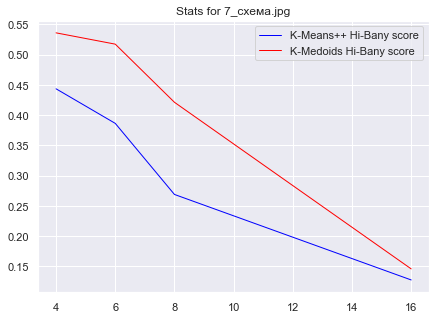

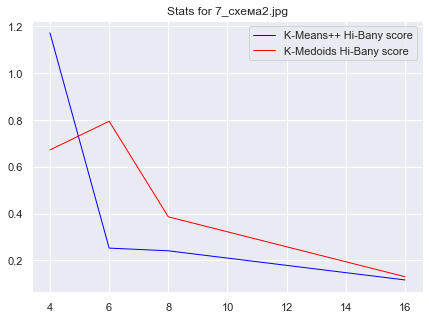

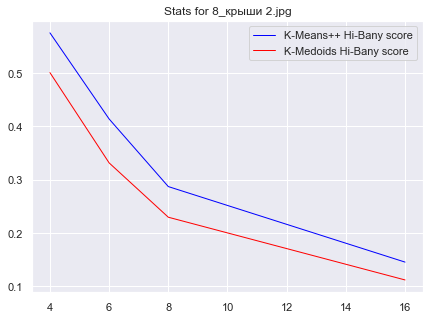

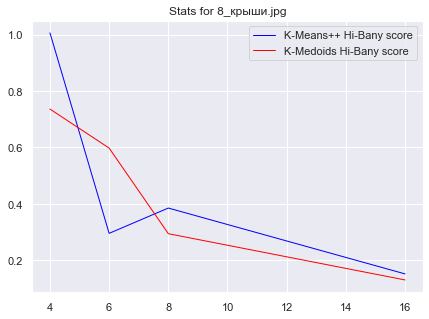

In [11]:
stats_1 = pd.DataFrame(stats_1)
for img_ in stats_1.img.unique():
  df1=stats_1[stats_1.img==img_]
  with sns.axes_style('darkgrid'):
    f, ax = plt.subplots(1, 1, figsize=(7,5))
    ax.plot(df1.num_clusters, df1.kmeansp_hibany, color="blue", 
            label="K-Means++ Hi-Bany score", linestyle="-")
    ax.plot(df1.num_clusters, df1.kmedoids_hibany, color="red", 
            label="K-Medoids Hi-Bany score", linestyle="-")
    plt.title(f'Stats for {img_}')
    ax.legend()
    plt.show()

## Conclusions: to sum up, we have performed 3 different clustering methods to accomplish image segmentation task: K-means (w. random centers initializer and w. smarter one - k-means++), fuzzy C-means and K-medoids. As we can see on graphs above, C-means usually outperforms K-means by Hi-Bany score and is as powerful as K-means++ and K-medoids, although the last one is the slowest one